In [1]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set Random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 1000) # for new results
print(f"Random Seed: {manualSeed}")
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed: 999


In [2]:
# Root directory for dataset
dataroot = "data/celeba"

workers = 2

batch_size = 128

# Spatial size of images, all images will be resized to this using a transformer
image_size = 64 

# number of channels in the image
nc = 3

# size of z latent vector (i.e. size of generator input)
nz = 100

# size of feature maps in generator
ngf = 64 

# size of feature maps in discriminator
ndf = 64

# number of training epochs
num_epochs = 5

# learning rate 
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

ngpu = 2

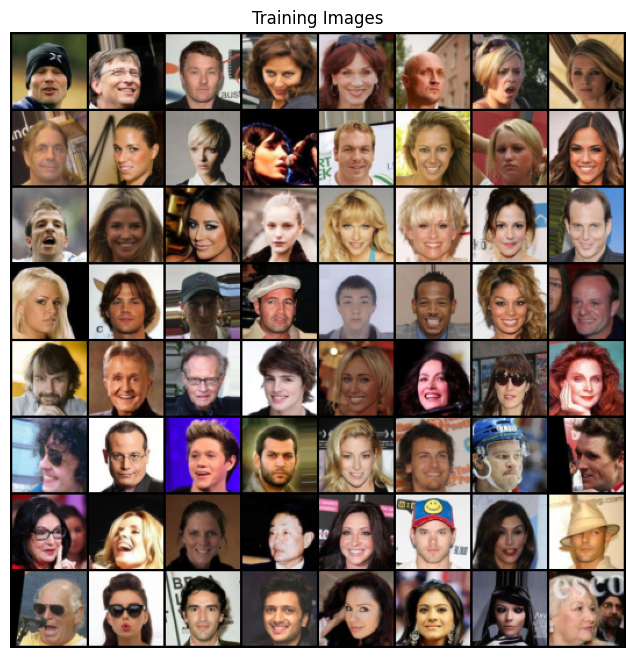

In [3]:
dataset = dset.ImageFolder(root=dataroot,
                          transform=transforms.Compose([
                              transforms.Resize(image_size),
                              transforms.CenterCrop(image_size),
                              transforms.ToTensor(),
                              transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)),
                          ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                        shuffle=True, num_workers=workers)

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

#plot sample training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64],
                                        padding=2, normalize=True).cpu(),(1,2,0)))

## Implementation
### Weight Initialization
 - From the DCGAN paper, the authors specify that all model weights shall be randomly initialized from a normal distribution with mean=0, stddev=0.02.

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator
 - The generator G is designed to map the latent space vector (z) to data-space
 - essentially, map the random noise to an RGB image with the same dimensions as the training images (3x64x64)
 - This is done via a series of strided 2D convolutional transposition layers, each paired with a 2d batch norm layer and a relu activation.
 - The output of the generator is fed through a tanh function to return it to the input data range of \[-1,1\].
 - The batch-norm layers are an important contribution of the DCGAN paper.

In [5]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z going into a convolution
            nn.ConvTranspose2d( nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(True),
            #state size. (ngf*8) * 4 * 4
            nn.ConvTranspose2d( ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            #state size. (ngf*4) * 8 * 8
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
            # state size. (ngf*2) * 16 * 16
            nn.ConvTranspose2d( ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) * 32 * 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh(),
            # state size. (nc) * 64 * 64
        )
        
    def forward(self, input):
        return self.main(input)
    

In [6]:
netG = Generator(ngpu).to(device)

# Handle multi-GPU 
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
    
# Custom weight initialization
netG.apply(weights_init)

print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2

## Discriminator
    - Uses Strided convolutions instead of pooling to downsample as it lets the network learn its own pooling function
    - BatchNorm and leaky ReLU promotes healthy gradient flow
    

In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2,inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2,inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2,inplace=True),
            # state size. (ndf*4) x 4 x 4
            nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, input):
        return self.main(input)

In [8]:
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD,list(range(ngpu)))
    
netD.apply(weights_init)

print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (12): Sigm

## Loss Functions and Optimizers
 - We use Binary Cross Entropy loss
 - This provides calculation of both log components in the objective function of GANs
 - We define the real label as 1 and the fake label as 0.
 - Two separate optimizers, one for D and one for G
 - Adam optimizers, lr=0.0002, Beta1=0.5.
 - We use latent vectors from Gaussian distribution

In [9]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1
fake_label = 0

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training 
 - Incorrect hyperparameter settings lead to mode collapse with little explanation of what went wrong
 - We construct different mini-batches for real and fake images and adjust G's objective function to maximize $logD(G(z))$.
 
 ### Training the Discriminator
  - We maximize $log(D(x)) + log(1-D(G(z))$
  - Separate mini-batches, we calculate the above in two steps.
   1. First, construct a batch of real samples from the training set, forward pass through D, calculate the loss $(log(D(x))$, the calculate the gradients in backward pass.
   2. Secondly, construct a batch of Fake samples with the current generator, forward pass this batch through D, calculate the loss $log(1-D(G(z))$, and *accumulate* the gradients with a backward pass.
  - Now the gradients are accumulated from both the all-real and all-fake batches, we call a step of the Discriminator's optimizer.
  
 ### Training the Generator
  - We want to minimize $log(1-D(G(z)))$
  - Instead, we maximize $log(D(G(z)))$ to get better gradients in the earlier stages
  - This is accomplished by  classifying the Generator output with the discriminator, computing G's loss using *real labels* as GT,computing G's gradients in a backward pass and updating by calling a step of the optimizer.
  - Using real labels as GT labels for the loss funciton allows us to use the $log(x)$ part of the BCELoss rather than the $log(1-x)$ part.

In [10]:
# Training Loop

img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")

# for each epoch
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        
        ##########################
        # (1) Update D network: maximize log(D(x)) + log(1-D(G(z)))
        ##########################
        ## Train with all real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float,
                          device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradient for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()
        
        ## Train with all fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        #Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradient for this batch, accumulated (summed) with the previous gradient
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Computer error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # update D
        optimizerD.step()
        
        ##########################
        # (2) Update G netork: maximize log(D(G(z)))
        ##########################
        netG.zero_grad()
        label.fill_(real_label) # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of the all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\t Loss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f' 
                  % (epoch, num_epochs, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            
        
        # Save losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check ho the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1


Starting Training Loop...
[0/5][0/1583]	 Loss_D: 1.8056	Loss_G: 8.3715	D(x): 0.6212	D(G(z)): 0.6611 / 0.0004
[0/5][50/1583]	 Loss_D: 0.0069	Loss_G: 22.9165	D(x): 0.9938	D(G(z)): 0.0000 / 0.0000
[0/5][100/1583]	 Loss_D: 0.6412	Loss_G: 14.8963	D(x): 0.8900	D(G(z)): 0.2761 / 0.0000
[0/5][150/1583]	 Loss_D: 0.6651	Loss_G: 4.6934	D(x): 0.7177	D(G(z)): 0.0242 / 0.0265
[0/5][200/1583]	 Loss_D: 0.3407	Loss_G: 5.7139	D(x): 0.9313	D(G(z)): 0.1916 / 0.0053
[0/5][250/1583]	 Loss_D: 0.8197	Loss_G: 3.7054	D(x): 0.7763	D(G(z)): 0.2588 / 0.0595
[0/5][300/1583]	 Loss_D: 1.3673	Loss_G: 5.8228	D(x): 0.9039	D(G(z)): 0.5811 / 0.0175
[0/5][350/1583]	 Loss_D: 1.2334	Loss_G: 6.5779	D(x): 0.8723	D(G(z)): 0.5469 / 0.0087
[0/5][400/1583]	 Loss_D: 0.6665	Loss_G: 3.5227	D(x): 0.6858	D(G(z)): 0.1363 / 0.0601
[0/5][450/1583]	 Loss_D: 0.7428	Loss_G: 4.4205	D(x): 0.7809	D(G(z)): 0.2620 / 0.0258
[0/5][500/1583]	 Loss_D: 0.8108	Loss_G: 3.6656	D(x): 0.7241	D(G(z)): 0.2877 / 0.0488
[0/5][550/1583]	 Loss_D: 0.7259	Loss_G: 

[3/5][0/1583]	 Loss_D: 0.9309	Loss_G: 3.5367	D(x): 0.8576	D(G(z)): 0.4696 / 0.0460
[3/5][50/1583]	 Loss_D: 0.5656	Loss_G: 1.9595	D(x): 0.7541	D(G(z)): 0.2089 / 0.1765
[3/5][100/1583]	 Loss_D: 0.8114	Loss_G: 1.4461	D(x): 0.5510	D(G(z)): 0.0836 / 0.2887
[3/5][150/1583]	 Loss_D: 0.5617	Loss_G: 2.1317	D(x): 0.7620	D(G(z)): 0.2176 / 0.1469
[3/5][200/1583]	 Loss_D: 0.6638	Loss_G: 3.8947	D(x): 0.8841	D(G(z)): 0.3674 / 0.0300
[3/5][250/1583]	 Loss_D: 0.8652	Loss_G: 1.1270	D(x): 0.5319	D(G(z)): 0.1245 / 0.3709
[3/5][300/1583]	 Loss_D: 0.7458	Loss_G: 1.7740	D(x): 0.5768	D(G(z)): 0.0924 / 0.2097
[3/5][350/1583]	 Loss_D: 1.0688	Loss_G: 4.6866	D(x): 0.9440	D(G(z)): 0.5959 / 0.0137
[3/5][400/1583]	 Loss_D: 0.5877	Loss_G: 2.1516	D(x): 0.7143	D(G(z)): 0.1869 / 0.1489
[3/5][450/1583]	 Loss_D: 0.7449	Loss_G: 2.7851	D(x): 0.8625	D(G(z)): 0.4048 / 0.0872
[3/5][500/1583]	 Loss_D: 0.7207	Loss_G: 1.6048	D(x): 0.6618	D(G(z)): 0.2074 / 0.2446
[3/5][550/1583]	 Loss_D: 1.0114	Loss_G: 0.9894	D(x): 0.4365	D(G(z)):

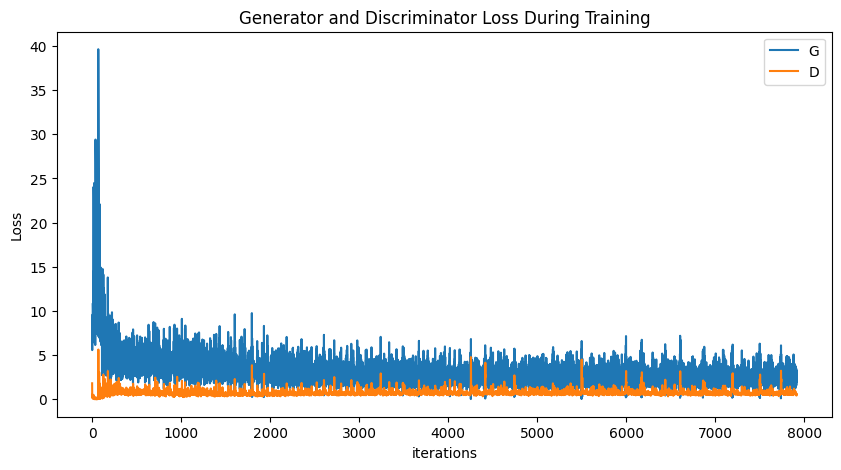

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

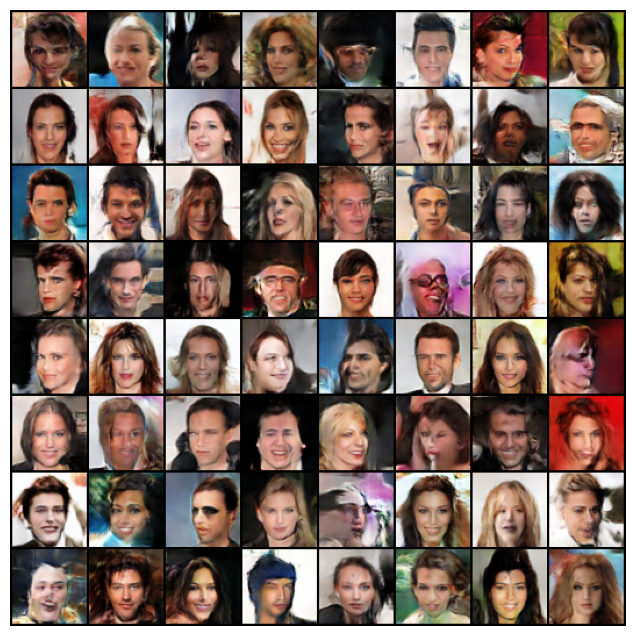

In [12]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())